In [76]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import random

## Set Parameters

In [77]:
num_trees = 10  # Number of trees
fireflies_per_tree = 5  # Fireflies per tree
K = 0.2  # Coupling constant
time_steps = 1000  # Total simulation steps
space_size = 100  # Boundary of the forest

## Initialize Forest

In [78]:
# Initialize tree positions randomly
tree_positions = np.random.rand(num_trees, 2) * space_size

# Initialize firefly phases and frequencies
firefly_phases = np.random.rand(num_trees, fireflies_per_tree) * 2 * np.pi  # Phases in [0, 2π]
firefly_frequencies = np.random.normal(0, 0.1, (num_trees, fireflies_per_tree))  # Natural frequencies

## Distance Based Influence

distance = $\sqrt{x^2 + y^2}$

In [79]:
def coupling_strength(pos1, pos2):
    dist = np.sqrt((pos1[0] - pos2[0])**2 + (pos1[1] - pos2[1])**2)
    return min(1 / dist, 1) if dist != 0 else 0  # Avoid division by zero for self-coupling

## Implement Kuramoto Model

In [80]:
def update_phases(tree_positions, firefly_phases, firefly_frequencies, K):
    new_phases = np.copy(firefly_phases)  # Copy current phases for synchronous updating

    # Iterate over all trees and fireflies
    for i in range(num_trees):
        for m in range(fireflies_per_tree):
            # Current firefly's phase and position
            phase_i = firefly_phases[i, m]
            pos_i = tree_positions[i]

            # Coupling sum for the Kuramoto update
            coupling_sum = 0
            for j in range(num_trees):
                for n in range(fireflies_per_tree):
                    if i == j and m == n:
                        continue  # Skip self-coupling

                    phase_j = firefly_phases[j, n]
                    pos_j = tree_positions[j]

                    # Apply coupling strength and phase difference
                    G_ij = coupling_strength(pos_i, pos_j)
                    coupling_sum += G_ij * np.sin(phase_j - phase_i)

            # Update phase using the Kuramoto model equation
            new_phases[i, m] += (firefly_frequencies[i, m] + K * coupling_sum)
    
    # Ensure phases are within [0, 2π]
    new_phases %= (2 * np.pi)
    
    return new_phases

## Run Simulation

In [81]:
# Run simulation
all_phases = [firefly_phases]  # Store phases over time for analysis or plotting

for t in range(time_steps):
    firefly_phases = update_phases(tree_positions, firefly_phases, firefly_frequencies, K)
    all_phases.append(firefly_phases)

# Convert to numpy array for easier manipulation
all_phases = np.array(all_phases)

## Visualize

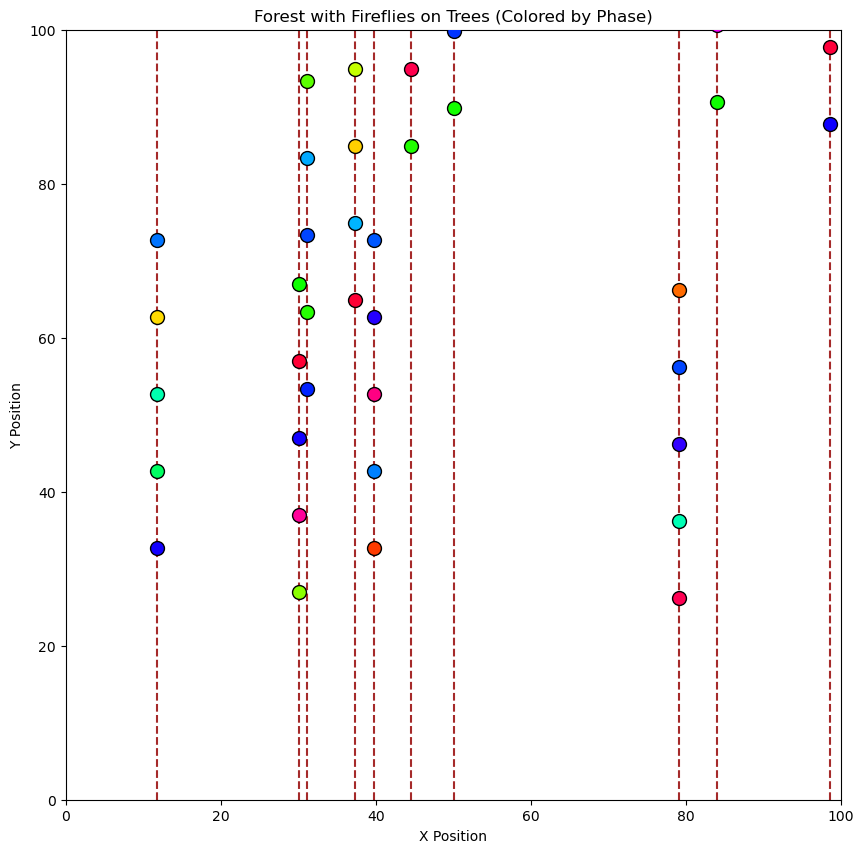

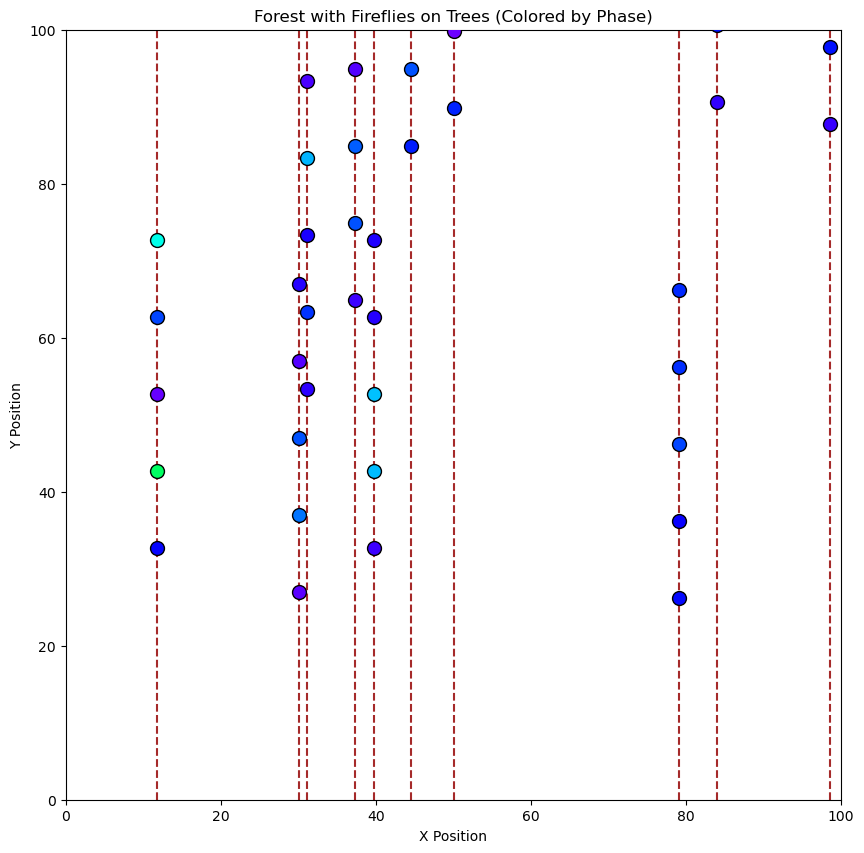

In [82]:
def plot_forest_with_fireflies(tree_positions, firefly_phases):
    plt.figure(figsize=(10, 10))
    plt.xlim(0, space_size)
    plt.ylim(0, space_size)
    
    for i, pos in enumerate(tree_positions):
        # Draw each tree as a vertical line at x=tree's x position
        x_pos = pos[0]
        plt.plot([x_pos, x_pos], [0, space_size], color="brown", linestyle="--", linewidth=1.5)

        # Draw each firefly as a dot along the line (y-coordinate randomly around tree's position)
        for m, phase in enumerate(firefly_phases[i]):
            # Firefly position along the tree
            y_pos = pos[1] + (m * (space_size / (2 * fireflies_per_tree)))  # Stagger fireflies along tree height
            
            # Set color based on phase, normalized to a hue value in [0, 1]
            color = plt.cm.hsv(phase / (2 * np.pi))
            plt.scatter(x_pos, y_pos, color=color, edgecolor="black", s=100, zorder=5)
    
    plt.xlabel("X Position")
    plt.ylabel("Y Position")
    plt.title("Forest with Fireflies on Trees (Colored by Phase)")
    plt.show()

# Plot the initial and final phase distributions of the fireflies on trees
plot_forest_with_fireflies(tree_positions, all_phases[0])  # Initial state
plot_forest_with_fireflies(tree_positions, all_phases[-1])  # Final state


## Analyze Synchronization

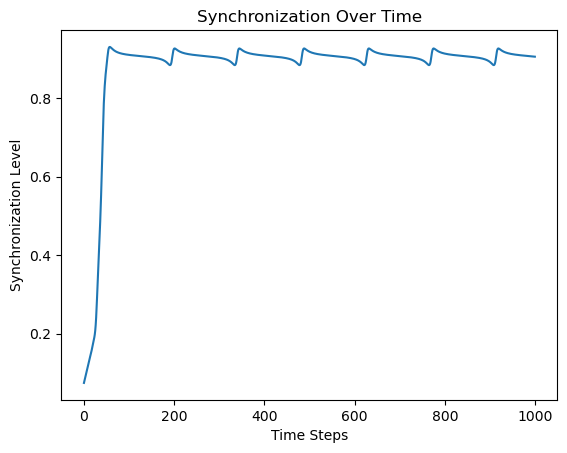

In [83]:
def order_parameter(phases):
    return np.abs(np.mean(np.exp(1j * phases)))  # Returns a value in [0, 1]

synchronization_levels = []
for t in range(time_steps):
    synchronization_levels.append(order_parameter(all_phases[t].flatten()))

# Plot synchronization levels
plt.plot(synchronization_levels)
plt.xlabel("Time Steps")
plt.ylabel("Synchronization Level")
plt.title("Synchronization Over Time")
plt.show()

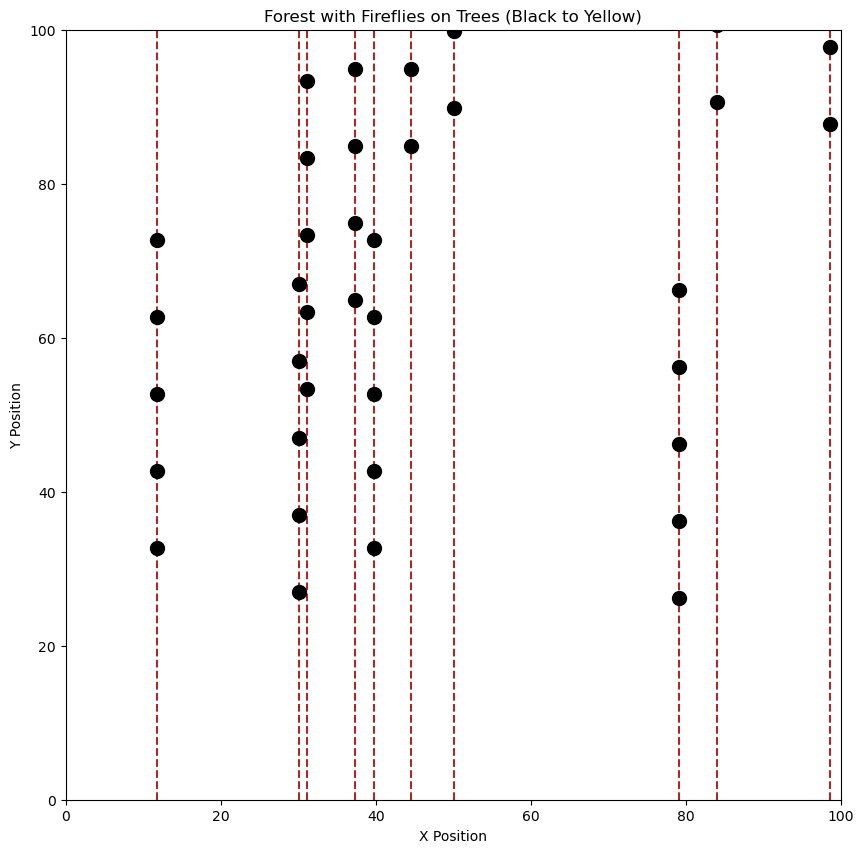

Animation size has reached 20986451 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [84]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
from IPython.display import HTML

# Assuming other setup variables and functions are defined (tree_positions, all_phases, etc.)

def animate_forest_with_fireflies(tree_positions, all_phases):
    fig, ax = plt.subplots(figsize=(10, 10))
    plt.xlim(0, space_size)
    plt.ylim(0, space_size)
    ax.set_xlabel("X Position")
    ax.set_ylabel("Y Position")
    ax.set_title("Forest with Fireflies on Trees (Black to Yellow)")

    # Draw the trees as static vertical lines
    for pos in tree_positions:
        x_pos = pos[0]
        ax.plot([x_pos, x_pos], [0, space_size], color="brown", linestyle="--", linewidth=1.5)

    # Create scatter objects for fireflies on each tree
    scatters = []
    for i, pos in enumerate(tree_positions):
        x_pos = pos[0]
        y_positions = pos[1] + np.arange(fireflies_per_tree) * (space_size / (2 * fireflies_per_tree))
        scatter = ax.scatter([x_pos] * fireflies_per_tree, y_positions, color='black', s=100, edgecolor="black", zorder=5)
        scatters.append(scatter)

    # Animation function to update firefly colors based on phase (black to yellow gradient)
    def update(frame):
        for i, scatter in enumerate(scatters):
            current_phases = all_phases[frame][i]

            # Map each phase to a black-yellow gradient
            colors = []
            for phase in current_phases:
                # Normalize phase to range from 0 (black) to 1 (yellow)
                normalized_phase = (1 + np.cos(phase)) / 2  # Cosine to smoothly map phase to [0, 1]
                color = (normalized_phase, normalized_phase, 0)  # RGB tuple from black to yellow
                colors.append(color)

            # Update scatter color
            scatter.set_color(colors)
        return scatters

    # Create the animation
    anim = FuncAnimation(fig, update, frames=len(all_phases), interval=50, blit=False)
    plt.show()
    return anim

# Run and display the animation
anim = animate_forest_with_fireflies(tree_positions, all_phases)
anim.save("forest_fireflies.mp4", writer="ffmpeg", fps=20)
HTML(anim.to_jshtml())



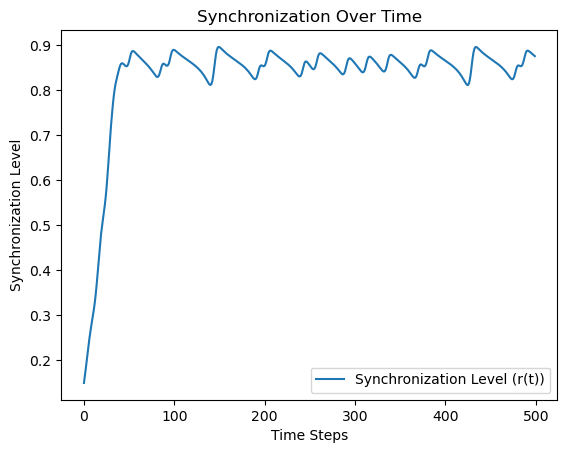

In [106]:
import pygame
import numpy as np
import matplotlib.pyplot as plt
import cmath
import random

# pygame initialization
pygame.init()
width, height = 800, 400
screen = pygame.display.set_mode((width, height))
clock = pygame.time.Clock()

# parameter choices
num_trees = 10 #number of trees
fireflies_per_tree = 5 #fireflie/tree
K = 0.25
time_steps = 500
tree_y_fixed = height - 100  # Fixed y position for trees
ground_height = 100  # Height of the ground area

# Tree positions along x-axis with fixed y-axis value
tree_positions = [(random.randint(50, width - 50), tree_y_fixed) for _ in range(num_trees)]

# Initialize fireflies near each tree with random phases and frequencies
fireflies = []
phases = []
frequencies = []
for (tree_x, tree_y) in tree_positions:
    for _ in range(fireflies_per_tree):
        # Firefly position with a small random offset around the tree along y-axis
        offset_x = random.randint(-15, 15)
        offset_y = random.randint(-15, 15)
        fireflies.append((tree_x + offset_x, tree_y + offset_y))
        
        # Random initial phase and natural frequency
        phases.append(random.uniform(0, 2 * np.pi))
        frequencies.append(np.random.normal(0, 0.1))

# Storage for synchronization measure over time
synchronization_levels = []

# Distance-based coupling strength with decay
def coupling_strength(pos1, pos2):
    dist = np.sqrt((pos1[0] - pos2[0])**2 + (pos1[1] - pos2[1])**2)
    return max(1 / (dist**2), 1) if dist != 0 else 1  # Avoid division by zero

# Function to calculate order parameter r(t)
def calculate_order_parameter(phases):
    complex_sum = sum(cmath.exp(1j * theta) for theta in phases)
    return abs(complex_sum) / len(phases)

# Main loop
running = True
t = 0
while running and t < time_steps:
    for event in pygame.event.get():
        if event.type == pygame.QUIT:
            running = False

    # Fill the screen with background color (sky)
    screen.fill((0, 29, 61))  # Dark blue for night sky

    # Draw the ground as a rectangle at the bottom of the screen
    pygame.draw.rect(screen, (34, 139, 34), (0, height - ground_height, width, ground_height))  # Green ground

    # Draw trees along the x-axis
    for (tree_x, tree_y) in tree_positions:
        pygame.draw.rect(screen, (139, 69, 19), (tree_x - 5, tree_y, 10, 30))  # Simple tree trunk
        pygame.draw.circle(screen, (34, 139, 34), (tree_x, tree_y - 15), 20)   # Simple tree foliage

    # Update phases based on the Kuramoto model with distance-based decay
    num_fireflies = len(fireflies)
    for i in range(num_fireflies):
        pos_i = fireflies[i]
        phase_i = phases[i]
        coupling_sum = 0
        
        for j in range(num_fireflies):
            if i != j:
                pos_j = fireflies[j]
                phase_j = phases[j]
                
                # Apply distance-based coupling decay
                G_ij = coupling_strength(pos_i, pos_j)
                coupling_sum += G_ij * np.sin(phase_j - phase_i)

        # Update phase based on coupling sum
        phases[i] += frequencies[i] + (K / num_fireflies) * coupling_sum

    # Calculate synchronization level
    r_t = calculate_order_parameter(phases)
    synchronization_levels.append(r_t)

    # Draw fireflies near their assigned tree positions
    for idx, (x, y) in enumerate(fireflies):
        # Map phase to yellow intensity
        intensity = int(255 * (1 + np.cos(phases[idx])) / 2)  # From 0 (black) to 255 (yellow)
        color = (intensity, intensity, 0)
        pygame.draw.circle(screen, color, (x, y), 5)

    pygame.display.flip()
    clock.tick(30)  # Control the frame rate
    t += 1

pygame.quit()

# Plot synchronization levels over time using matplotlib
plt.plot(synchronization_levels, label="Synchronization Level (r(t))")
plt.xlabel("Time Steps")
plt.ylabel("Synchronization Level")
plt.title("Synchronization Over Time")
plt.legend()
plt.show()


KeyboardInterrupt: 